#### **0)  Prerequisites (Notes):**


Refer to ```qa_aggregate.py``` and ```preload_aggregate.py``` for the extraction process of temporal aggregates by annual, monthly, weekday-weekend, and hourly intervals from 2023 September and 2024 August. The plots and maps in this notebook were made accordingly using the processed images from implementing the functions in ```preload.aggregate.py``` on Atlantic Canada and the Quebec City-Windsor corridor spatial extents.

Furthermore, in the ```/download/``` folder, refer to ```tempo.py``` and ```tropomi.py``` for getting Level 3 data and grid coordinate (Latitude/Longitude) arrays of TEMPO and TROPOMI respectively. Meanwhile, the locations of surface regulatory monitors were based on the outputs from ```airnow.py``` in the same folder. The Canadian census tract / dissemination area boundaries were used in city-level mapping, refer to ```census.py``` for details.

Below lists all the packages required for running this notebook.

In [ ]:
!pip install contextily
!pip install geoplot
!pip install rioxarray
!pip install basemap-data-hires
!pip install basemap
!pip install matplotlib_scalebar
!pip install exactextract

In [ ]:
import numpy as np
import xarray as xr
import rioxarray as rxr
import rasterio as rio
import pandas as pd
import geopandas as gpd
import exactextract as eet
import math
import os
import pickle
import copy
import contextily
import seaborn

In [ ]:
from matplotlib import pyplot as plt
from mpl_toolkits.basemap import Basemap
from mpl_toolkits.axes_grid1.axes_divider import make_axes_locatable
from matplotlib_scalebar.scalebar import ScaleBar
from matplotlib import gridspec
from matplotlib import colors
from matplotlib import colorbar
from matplotlib import ticker
from shapely import Polygon, Point
from shapely.ops import nearest_points
from rasterio.fill import fillnodata
from scipy import ndimage
from osgeo import gdal

In [ ]:
import warnings
warnings.filterwarnings("ignore")

#### **1) Annual and Seasonal distributions:**

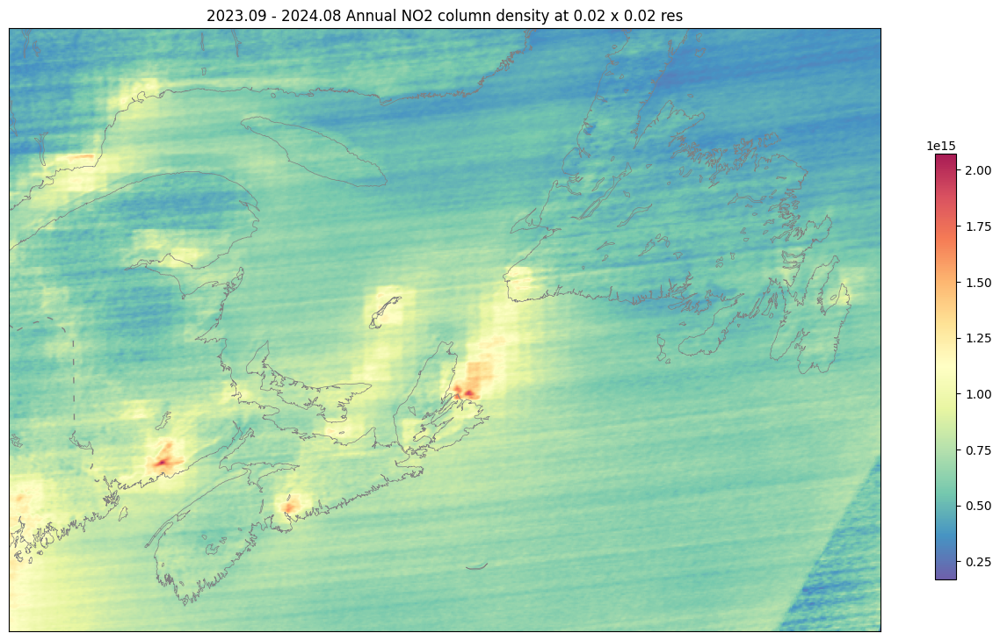

In [ ]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16, 9))

southend = 43.05
northend = 51.05
westend = -69.05
eastend = -52.05

## annual mean TEMPO NO2 VCD (2023/09 - 2024/08)

tem = copy.deepcopy(no2_annual_atl)

# create a base map
m = Basemap(projection='merc',
            llcrnrlon = westend,
            llcrnrlat = southend,
            urcrnrlon = eastend,n
            urcrnrlat = northend,
            resolution='h',
            ax = ax)
m.drawcoastlines(color='#808080', linewidth=0.5)
m.drawcountries(color='#808080', linewidth=1, linestyle=(0, (5, 10)))

p = m.imshow(tem, origin="upper", cmap='Spectral_r', alpha=0.9)

plt.title("2023.09 - 2024.08 Annual NO2 column density at 0.02 x 0.02 res")
fig.colorbar(p, ax=ax, location='right', anchor=(0, 0.3), shrink=0.7)

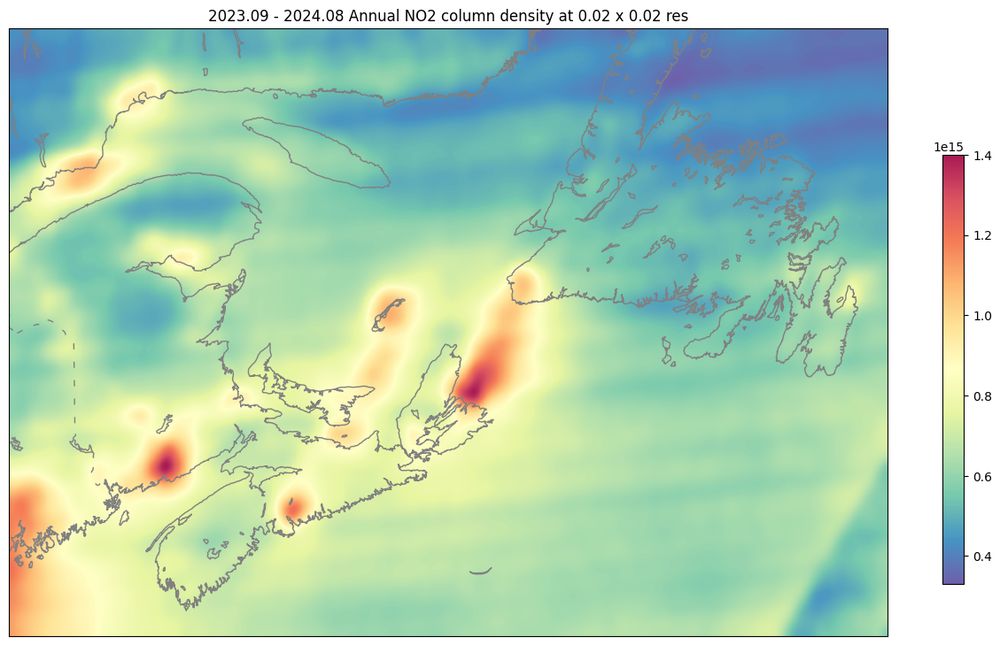

In [ ]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16, 9))

southend = 43.05
northend = 51.05
westend = -69.05
eastend = -52.05

## annual mean TEMPO NO2 VCD (2023/09 - 2024/08)

tem = copy.deepcopy(no2_annual_atl)

# gaussian filter for reducing striping
tem = ndimage.gaussian_filter(
        fillnodata(
            np.nan_to_num(tem),
            mask = np.ma.masked_array(np.nan_to_num(tem), 0),
            max_search_distance=100,
            smoothing_iterations=0
        ),
        sigma=(5, 5),
        order=0
      )

# create a base map
m = Basemap(projection='merc',
            llcrnrlon = westend,
            llcrnrlat = southend,
            urcrnrlon = eastend,
            urcrnrlat = northend,
            resolution='h',
            ax = ax)
m.drawcoastlines(color='#808080', linewidth=1)
m.drawcountries(color='#808080', linewidth=1, linestyle=(0, (5, 10)))

p = m.imshow(tem, origin="upper", cmap='Spectral_r', alpha=0.9)

plt.title("2023.09 - 2024.08 Annual NO2 column density at 0.02 x 0.02 res")
fig.colorbar(p, ax=ax, location='right', anchor=(0, 0.3), shrink=0.7)

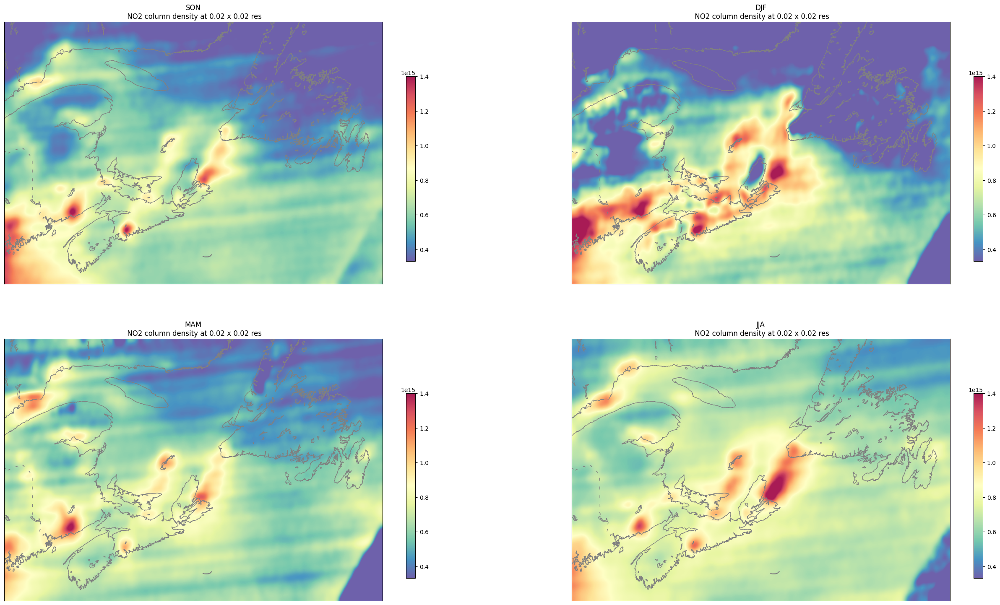

In [ ]:
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(32, 18))

southend = 43.05
northend = 51.05
westend = -69.05
eastend = -52.05


#  Get a common range of max-min values (annual conc.) FOR VISUALIZATION (not rescaling the seasonal distribution)

annual_val = copy.deepcopy(no2_annual_atl)

annual_val = ndimage.gaussian_filter(
        fillnodata(
            np.nan_to_num(annual_val),
            mask = np.ma.masked_array(np.nan_to_num(annual_val), 0),
            max_search_distance=100,
            smoothing_iterations=0
        ),
        sigma=(5, 5),
        order=0
      )

max_val = np.nanmax(annual_val)
min_val = np.nanmin(annual_val)


#  Plotting
r_counter, c_counter, total_counter = 0, 0, 0

for k in no2_seasonal_atl.keys():

    tem = copy.deepcopy(no2_seasonal_atl[k])

    # gaussian filter for reducing striping
    tem = ndimage.gaussian_filter(
            fillnodata(
                np.nan_to_num(tem),
                mask = np.ma.masked_array(np.nan_to_num(tem), 0),
                max_search_distance=100,
                smoothing_iterations=0
            ),
            sigma=(5, 5),
            order=0
          )

    # create a base map
    m = Basemap(projection='merc',
                llcrnrlon = westend,
                llcrnrlat = southend,
                urcrnrlon = eastend,
                urcrnrlat = northend,
                resolution='h',
                ax = ax[r_counter, c_counter])
    m.drawcoastlines(color='#808080', linewidth=1)
    m.drawcountries(color='#808080', linewidth=1, linestyle=(0, (5, 10)))

    p = m.imshow(tem, origin="upper", cmap='Spectral_r', vmin=min_val, vmax=max_val, alpha=0.9)

    ax[r_counter, c_counter].set_title(k + "\n NO2 column density at 0.02 x 0.02 res")
    fig.colorbar(p, ax=ax[r_counter, c_counter], location='right', anchor=(0, 0.3), shrink=0.7)

    total_counter += 1
    if total_counter % 2 == 0:
        r_counter += 1
        c_counter = 0
    else:
        c_counter += 1

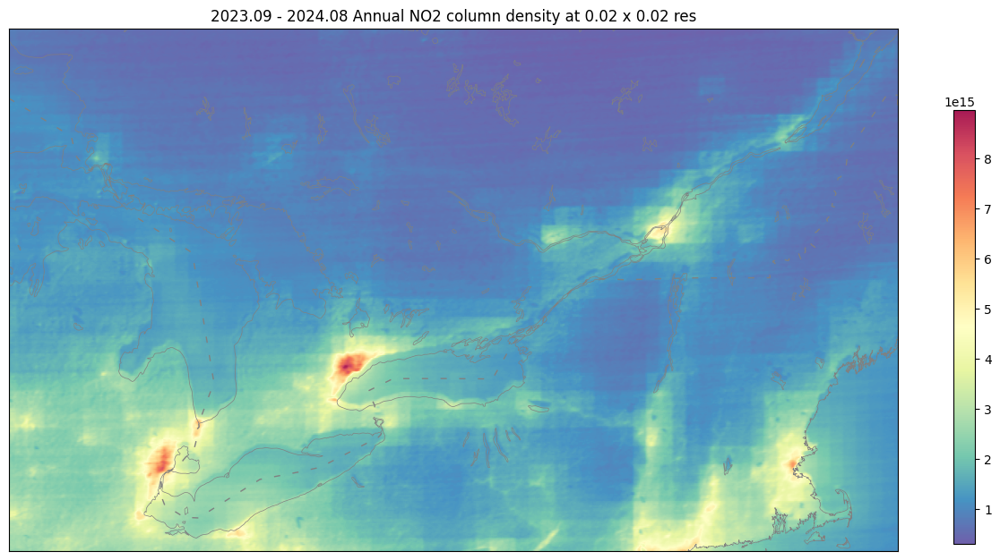

In [ ]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16, 9))

southend = 41.20
northend = 48.30
westend = -86.05
eastend = -69.05

## annual mean TEMPO NO2 VCD (2023/09 - 2024/08)

tem = copy.deepcopy(no2_annual_qw)

# create a base map
m = Basemap(projection='merc',
            llcrnrlon = westend,
            llcrnrlat = southend,
            urcrnrlon = eastend,
            urcrnrlat = northend,
            resolution='h',
            ax = ax)
m.drawcoastlines(color='#808080', linewidth=0.5)
m.drawcountries(color='#808080', linewidth=1, linestyle=(0, (5, 10)))

p = m.imshow(tem, origin="upper", cmap='Spectral_r', alpha=0.9)

plt.title("2023.09 - 2024.08 Annual NO2 column density at 0.02 x 0.02 res")
fig.colorbar(p, ax=ax, location='right', anchor=(0, 0.3), shrink=0.7)

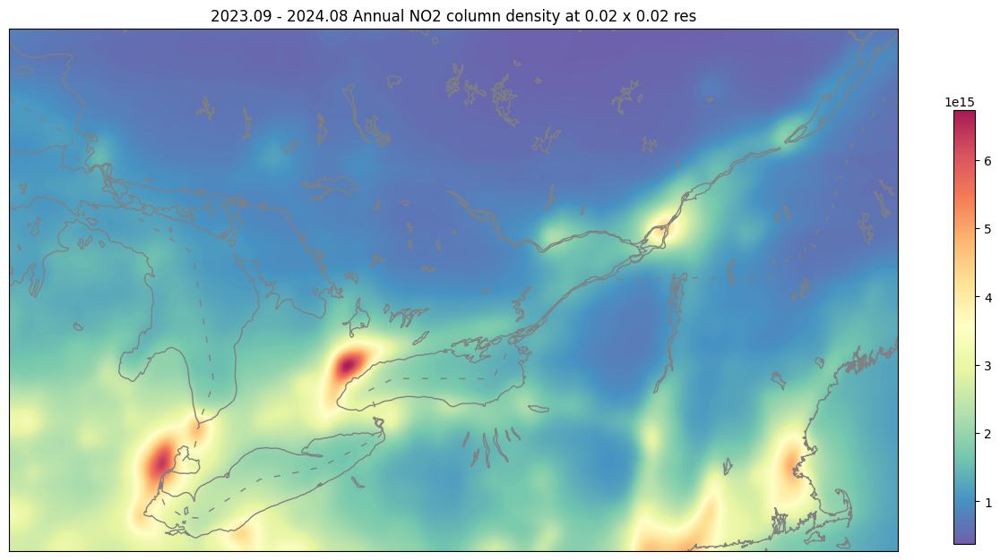

In [ ]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16, 9))

southend = 41.20
northend = 48.30
westend = -86.05
eastend = -69.05

## annual mean TEMPO NO2 VCD (2023/09 - 2024/08)

tem = copy.deepcopy(no2_annual_qw)

# gaussian filter for reducing striping
tem = ndimage.gaussian_filter(
        fillnodata(
            np.nan_to_num(tem),
            mask = np.ma.masked_array(np.nan_to_num(tem), 0),
            max_search_distance=100,
            smoothing_iterations=0
        ),
        sigma=(5, 5),
        order=0
      )

# create a base map
m = Basemap(projection='merc',
            llcrnrlon = westend,
            llcrnrlat = southend,
            urcrnrlon = eastend,
            urcrnrlat = northend,
            resolution='h',
            ax = ax)
m.drawcoastlines(color='#808080', linewidth=1)
m.drawcountries(color='#808080', linewidth=1, linestyle=(0, (5, 10)))

p = m.imshow(tem, origin="upper", cmap='Spectral_r', alpha=0.9)

plt.title("2023.09 - 2024.08 Annual NO2 column density at 0.02 x 0.02 res")
fig.colorbar(p, ax=ax, location='right', anchor=(0, 0.3), shrink=0.7)

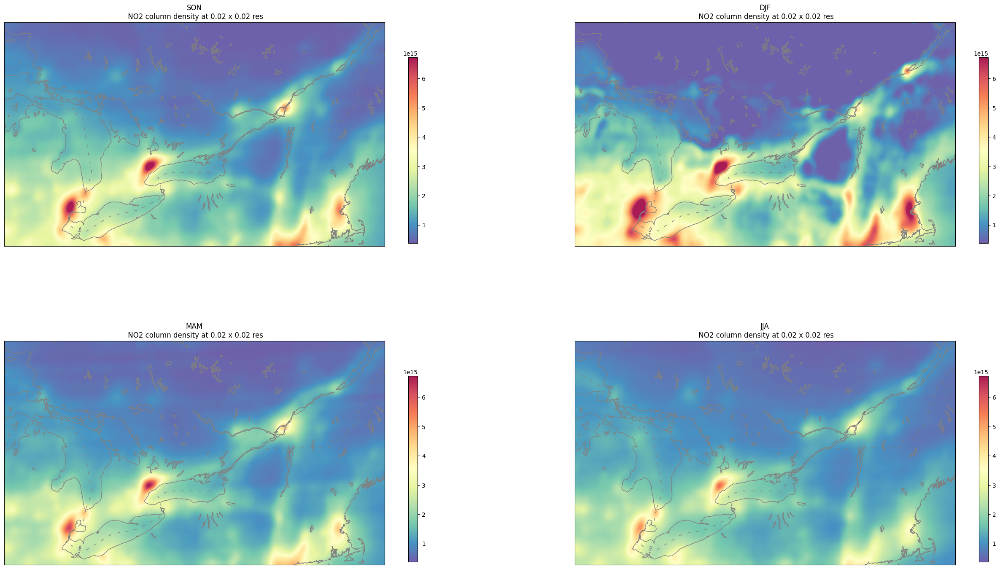

In [ ]:
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(32, 18))

southend = 41.20
northend = 48.30
westend = -86.05
eastend = -69.05


#  Get a common range of max-min values (annual conc.) FOR VISUALIZATION (not rescaling the seasonal distribution)

annual_val = copy.deepcopy(no2_annual_qw)

annual_val = ndimage.gaussian_filter(
        fillnodata(
            np.nan_to_num(annual_val),
            mask = np.ma.masked_array(np.nan_to_num(annual_val), 0),
            max_search_distance=100,
            smoothing_iterations=0
        ),
        sigma=(5, 5),
        order=0
      )

max_val = np.nanmax(annual_val)
min_val = np.nanmin(annual_val)


#  Plotting
r_counter, c_counter, total_counter = 0, 0, 0

for k in no2_seasonal_qw_negatives.keys():

    tem = copy.deepcopy(no2_seasonal_qw)

    tem = ndimage.gaussian_filter(
            fillnodata(
                np.nan_to_num(tem),
                mask = np.ma.masked_array(np.nan_to_num(tem), 0),
                max_search_distance=100,
                smoothing_iterations=0
            ),
            sigma=(5, 5),
            order=0
          )

    # create a base map
    m = Basemap(projection='merc',
                llcrnrlon = westend,
                llcrnrlat = southend,
                urcrnrlon = eastend,
                urcrnrlat = northend,
                resolution='h',
                ax = ax[r_counter, c_counter])
    m.drawcoastlines(color='#808080', linewidth=1)
    m.drawcountries(color='#808080', linewidth=1, linestyle=(0, (5, 10)))

    p = m.imshow(tem, origin="upper", cmap='Spectral_r', vmin=min_val, vmax=max_val, alpha=0.9)

    ax[r_counter, c_counter].set_title(k + "\n NO2 column density at 0.02 x 0.02 res")
    fig.colorbar(p, ax=ax[r_counter, c_counter], location='right', anchor=(0, 0.3), shrink=0.7)

    total_counter += 1
    if total_counter % 2 == 0:
        r_counter += 1
        c_counter = 0
    else:
        c_counter += 1

In [ ]:
####  accommodate numpy arrays to xarray datasets

def fetch_plot_Xr(aggregate, coords):

    plot_gdf = copy.deepcopy(coords)
    plot_gdf["observation"] = aggregate.flatten()

    plot_xr = xr.Dataset.from_dataframe(plot_gdf.set_index(['longitude','latitude']))
    plot_xr = plot_xr.rio.write_crs("epsg:4326")
    plot_xr = plot_xr.rename({"longitude": "x", "latitude": "y"})
    plot_xr = plot_xr.transpose("y", "x")
    plot_xr = plot_xr.reindex(y=list(reversed(plot_xr.y)))

    return plot_xr

In [ ]:
##  read TEMPO coordinate arrays

with open(f"./coord_array_atl.pkl", "rb") as f:
    coord_atl = pickle.load(f)

with open(f"./coord_array_qw.pkl", "rb") as f:
    coord_qw = pickle.load(f)

##  convert arrays to dataframes

coord_atl_gdf = gpd.GeoDataFrame({
    "longitude": coord_atl[:,:,0].flatten(),
    "latitude": coord_atl[:,:,1].flatten(),
})
coord_qw_gdf = gpd.GeoDataFrame({
    "longitude": coord_qw[:,:,0].flatten(),
    "latitude": coord_qw[:,:,1].flatten(),
})

##  convert dataframes to xarray datasets

no2_annual_atl_xr = fetch_plot_Xr(no2_annual_atl, coord_atl_gdf)
no2_annual_qw_xr = fetch_plot_Xr(no2_annual_qw, coord_qw_gdf)

In [ ]:
#  read GEE exported TROPOMI images

##  1-year mean

tropomi_atl = gdal.Open(f"./TROPOMI 202309-202408/Tropomi_NO2_1yr_mean_atl.tif")
tropomi_atl = np.array(tropomi_atl.GetRasterBand(1).ReadAsArray())

tropomi_qw = gdal.Open(f"./TROPOMI 202309-202408/Tropomi_NO2_1yr_mean_qw.tif")
tropomi_qw = np.array(tropomi_qw.GetRasterBand(1).ReadAsArray())

##  5-year mean

tropomi_5yr_atl = gdal.Open(f"./TROPOMI 201809-202308/Tropomi_NO2_5yr_mean_atl.tif")
tropomi_5yr_atl = np.array(tropomi_5yr_atl.GetRasterBand(1).ReadAsArray())

tropomi_5yr_qw = gdal.Open(f"./TROPOMI 201809-202308/Tropomi_NO2_5yr_mean_qw.tif")
tropomi_5yr_qw = np.array(tropomi_5yr_qw.GetRasterBand(1).ReadAsArray())

#  convert units from mol/m2 to molec/cm2

tropomi_atl = tropomi_atl * 6.022e23 / 1e4
tropomi_qw = tropomi_qw * 6.022e23 / 1e4
tropomi_5yr_atl = tropomi_5yr_atl * 6.022e23 / 1e4
tropomi_5yr_qw = tropomi_5yr_qw * 6.022e23 / 1e4

In [ ]:
##  read TROPOMI coordinate arrays

with open(f"./coord_array_tropomi_atl.pkl", "rb") as f:
    coord_tropomi_atl = pickle.load(f)

with open(f"./coord_array_tropomi_qw.pkl", "rb") as f:
    coord_tropomi_qw = pickle.load(f)

##  convert arrays to dataframes

coord_atl_gdf_tropomi = gpd.GeoDataFrame({
    "longitude": coord_tropomi_atl[:,:,0].flatten(),
    "latitude": coord_tropomi_atl[:,:,1].flatten(),
})
coord_qw_gdf_tropomi = gpd.GeoDataFrame({
    "longitude": coord_tropomi_qw[:,:,0].flatten(),
    "latitude": coord_tropomi_qw[:,:,1].flatten(),
})

##  convert dataframes to xarray datasets

no2_annual_tropomi_atl_xr = fetch_plot_Xr(tropomi_atl, coord_atl_gdf_tropomi)
no2_annual_tropomi_atl_5yr_xr = fetch_plot_Xr(tropomi_5yr_atl, coord_atl_gdf_tropomi)

no2_annual_tropomi_qw_xr = fetch_plot_Xr(tropomi_qw, coord_qw_gdf_tropomi)
no2_annual_tropomi_qw_5yr_xr = fetch_plot_Xr(tropomi_5yr_qw, coord_qw_gdf_tropomi)

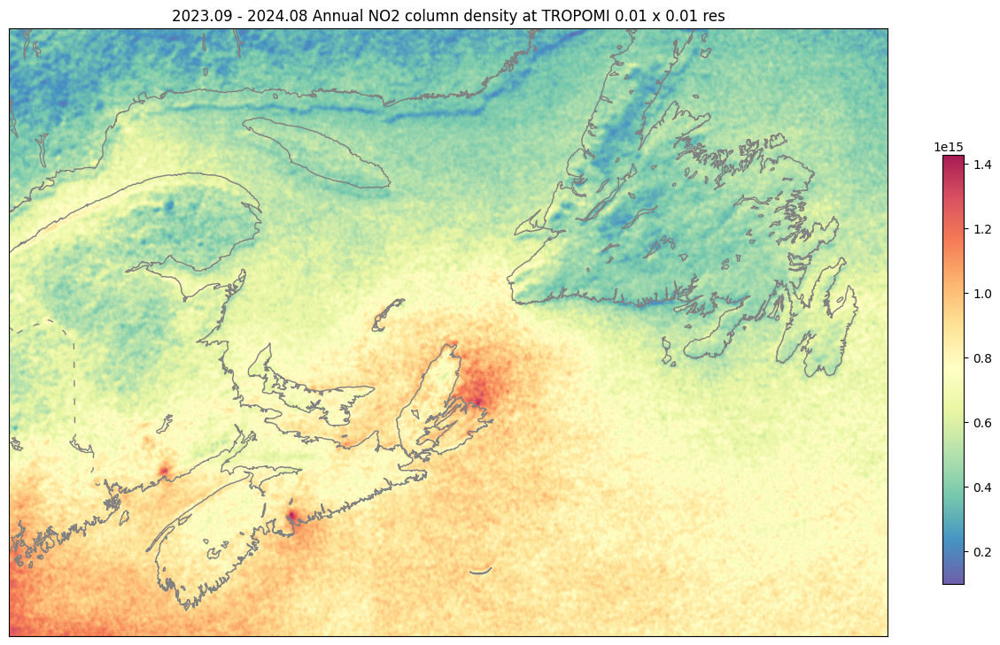

In [ ]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16, 9))

southend = 43.05
northend = 51.05
westend = -69.05
eastend = -52.05

## annual mean TROPOMI NO2 VCD (2023/09 - 2024/08)

plot_xr = copy.deepcopy(no2_annual_tropomi_atl_xr)

plot_xr = plot_xr.transpose("y", "x")
plot_xr = plot_xr.reindex(y=list(reversed(plot_xr.y)))

## remove NaN striping lines at around the mid points along Lat and Lon ranges
plot_xr = plot_xr.interpolate_na(dim="y", method="linear").interpolate_na(dim="x", method="linear")

plot_xr = plot_xr.transpose("y", "x")
plot_xr = plot_xr.reindex(y=list(reversed(plot_xr.y)))

# create a base map
m = Basemap(projection='merc',
            llcrnrlon = westend,
            llcrnrlat = southend,
            urcrnrlon = eastend,
            urcrnrlat = northend,
            resolution='h',
            ax = ax)
m.drawcoastlines(color='#808080', linewidth=1)
m.drawcountries(color='#808080', linewidth=1, linestyle=(0, (5, 10)))

p = m.imshow(plot_xr.observation.values, origin="upper", cmap='Spectral_r', alpha=0.9)

plt.title("2023.09 - 2024.08 Annual NO2 column density at TROPOMI 0.01 x 0.01 res")
fig.colorbar(p, ax=ax, location='right', anchor=(0, 0.3), shrink=0.7)

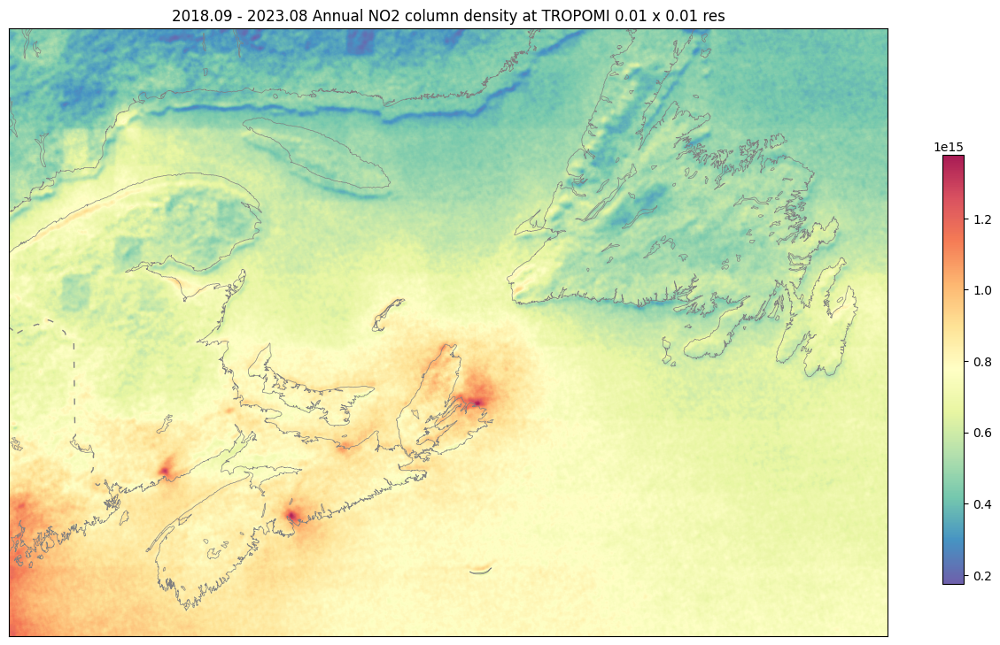

In [ ]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16, 9))

southend = 43.05
northend = 51.05
westend = -69.05
eastend = -52.05

##  5-year mean TROPOMI NO2 VCD (2018/09 - 2023/08)

# create a base map
m = Basemap(projection='merc',
            llcrnrlon = westend,
            llcrnrlat = southend,
            urcrnrlon = eastend,
            urcrnrlat = northend,
            resolution='h',
            ax = ax)
m.drawcoastlines(color='#808080', linewidth=0.5)
m.drawcountries(color='#808080', linewidth=1, linestyle=(0, (5, 10)))

p = m.imshow(tropomi_5yr_atl, origin="upper", cmap='Spectral_r', alpha=0.9)

plt.title("2018.09 - 2023.08 Average NO2 column density at TROPOMI 0.01 x 0.01 res")
fig.colorbar(p, ax=ax, location='right', anchor=(0, 0.3), shrink=0.7)

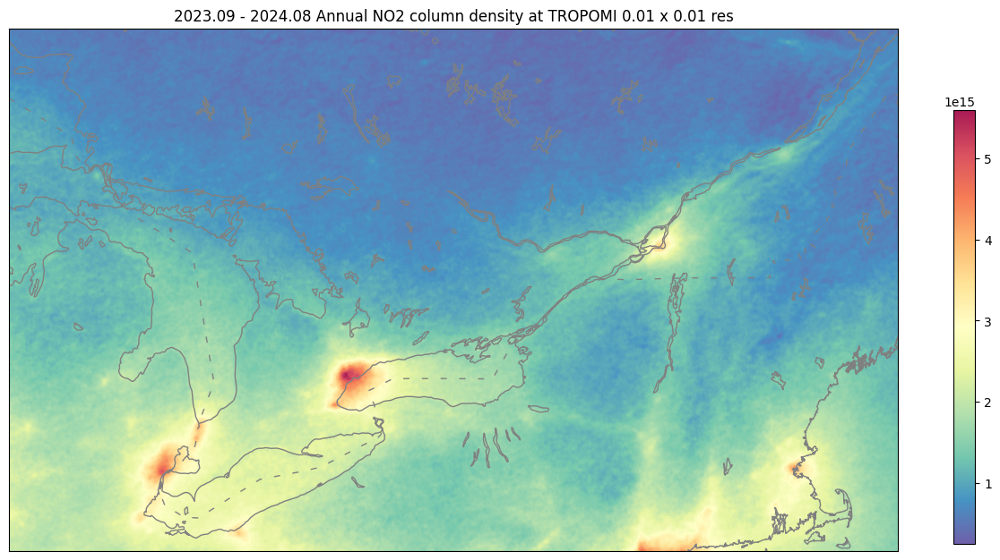

In [ ]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16, 9))

southend = 41.20
northend = 48.30
westend = -86.05
eastend = -69.05

## annual mean TROPOMI NO2 VCD (2023/09 - 2024/08)

plot_xr = copy.deepcopy(no2_annual_tropomi_qw_xr)

plot_xr = plot_xr.transpose("y", "x")
plot_xr = plot_xr.reindex(y=list(reversed(plot_xr.y)))

## remove NaN striping lines at around the mid points along Lat and Lon ranges
plot_xr = plot_xr.interpolate_na(dim="x", method="linear")

plot_xr = plot_xr.transpose("y", "x")
plot_xr = plot_xr.reindex(y=list(reversed(plot_xr.y)))

# create a base map
m = Basemap(projection='merc',
            llcrnrlon = westend,
            llcrnrlat = southend,
            urcrnrlon = eastend,
            urcrnrlat = northend,
            resolution='h',
            ax = ax)
m.drawcoastlines(color='#808080', linewidth=1)
m.drawcountries(color='#808080', linewidth=1, linestyle=(0, (5, 10)))

p = m.imshow(plot_xr.observation.values, origin="upper", cmap='Spectral_r', alpha=0.9)

plt.title("2023.09 - 2024.08 Annual NO2 column density at TROPOMI 0.01 x 0.01 res")
fig.colorbar(p, ax=ax, location='right', anchor=(0, 0.3), shrink=0.7)

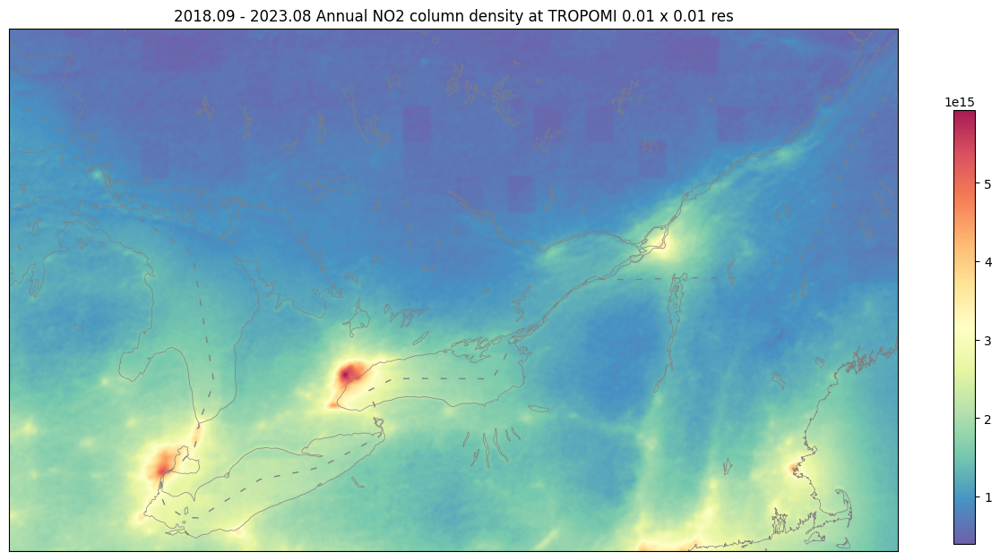

In [ ]:
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(16, 9))

southend = 41.20
northend = 48.30
westend = -86.05
eastend = -69.05

##  5-year mean TROPOMI NO2 VCD (2018/09 - 2023/08)

# create a base map
m = Basemap(projection='merc',
            llcrnrlon = westend,
            llcrnrlat = southend,
            urcrnrlon = eastend,
            urcrnrlat = northend,
            resolution='h',
            ax = ax)
m.drawcoastlines(color='#808080', linewidth=0.5)
m.drawcountries(color='#808080', linewidth=1, linestyle=(0, (5, 10)))

p = m.imshow(tropomi_5yr_qw, origin="upper", cmap='Spectral_r', alpha=0.9)

plt.title("2018.09 - 2023.08 Average NO2 column density at TROPOMI 0.01 x 0.01 res")
fig.colorbar(p, ax=ax, location='right', anchor=(0, 0.3), shrink=0.7)

In [ ]:
##  AirNow NO2 surface monitoring station locations

stations = gpd.read_file(f'./airnow_no2_stations.shp')

atl_stations = stations[(stations["Longitude"] > -69.05) &
                        (stations["Latitude"] > 43.05) &
                        (stations["Longitude"] < -52.05) &
                        (stations["Latitude"] < 51.05)].reset_index(drop=True)

qw_stations = stations[(stations["Longitude"] > -86.05) &
                        (stations["Latitude"] > 41.20) &
                        (stations["Longitude"] < -69.05) &
                        (stations["Latitude"] < 48.20)].reset_index(drop=True)

In [ ]:
###  subsetting spatial extent

def generate_geographical_subset(data_arrays, latmin, latmax, lonmin, lonmax):

    return data_arrays.where(
              (data_arrays.y < latmax) &
              (data_arrays.y > latmin) &
              (data_arrays.x < lonmax) &
              (data_arrays.x > lonmin),
            drop=True)

In [ ]:
###  city-level geometry for the eight selected municipalities

def city_subset(pname, source_xr, interp=True):

    subset_plot_xr = generate_geographical_subset(source_xr,
                                                  min(pc_coords[pname][1]) - 0.02,
                                                  max(pc_coords[pname][1]) + 0.02,
                                                  min(pc_coords[pname][0]) - 0.02,
                                                  max(pc_coords[pname][0]) + 0.02)

    if interp:
        out = subset_plot_xr.interp(x = pc_coords[pname][0],
                                    y = pc_coords[pname][1],
                                    method = "linear")
    else:
        out = subset_plot_xr

    return out

In [ ]:
def city_convert_gdf(pname, source_xr):

    source_xr = source_xr.to_dataframe().reset_index()
    source_xr['y'] = source_xr['y'].apply(lambda x: round(x, 6))
    source_xr['x'] = source_xr['x'].apply(lambda x: round(x, 6))
    source_xr = pc_grids_coords[pname].merge(source_xr, left_on=["lon","lat"], right_on=["x","y"])

    return source_xr

In [ ]:
def city_plot_with_stations(pname, source_xr, ax, aggregate_key=None, vmax=None, vmin=None, title=True, fill_point_color="slategrey", edge_point_color="black", edge_point_width = 1):

    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.1)

    if vmax != None and vmin != None:
        source_xr.plot(
            ax=ax,
            cax = cax,
            column="observation",
            cmap="Spectral_r",
            edgecolor="0.8",
            linewidth=0.1,
            alpha=0.5,
            aspect=None,
            legend=True,
            legend_kwds={
                "shrink":0.9,
            },
            vmax=vmax,
            vmin=vmin
        )
    else:
        source_xr.plot(
            ax=ax,
            cax = cax,
            column="observation",
            cmap="Spectral_r",
            edgecolor="0.8",
            linewidth=0.1,
            alpha=0.5,
            aspect=None,
            legend=True,
            legend_kwds={
                "shrink":0.9,
            }
        )

    bound_stations = stations[(stations['Longitude'] >= np.min(source_xr.x.values)) &
                              (stations['Longitude'] <= np.max(source_xr.x.values)) &
                              (stations['Latitude'] >= np.min(source_xr.y.values)) &
                              (stations['Latitude'] <= np.max(source_xr.y.values))]
    bound_stations.plot(
        ax = ax,
        color = fill_point_color,
        markersize = 100,
        edgecolor = edge_point_color,
        linewidth = edge_point_width,
    )

    contextily.add_basemap(
        ax=ax,
        crs="epsg:4326",
        source=contextily.providers.CartoDB.PositronNoLabels,
        zoom=12
    )

    points = gpd.GeoSeries(
        [Point(min(pc_coords[pname][0]) - 0.02, min(pc_coords[pname][1]) - 0.02),
         Point(min(pc_coords[pname][0]) - 0.02 + 1.0, min(pc_coords[pname][1]) - 0.02)], crs=4326
    )
    points = points.to_crs(3347)
    scale_meters = points[0].distance(points[1])
    ax.add_artist(ScaleBar(scale_meters, font_properties={"size": 14}))

    if title:
        ax.set_title(pname + " " + aggregate_key, fontsize=15)

    cax.tick_params(labelsize=15)

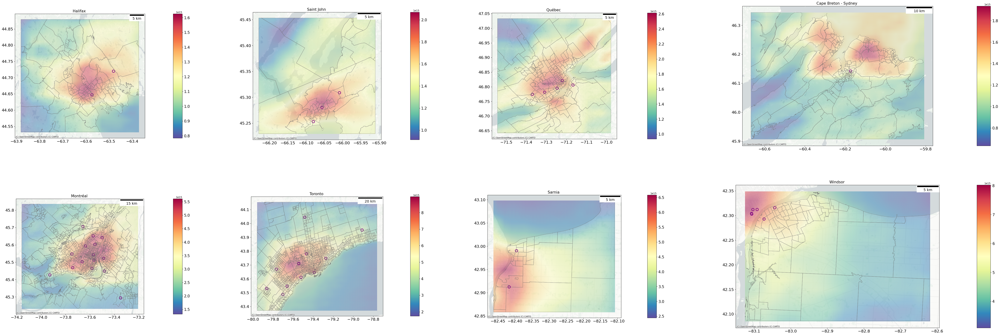

In [ ]:
###  TEMPO annual average (2023/09 - 2024/08)

fig = plt.figure(figsize=(16*3 + 24, 12*2))
gspec = gridspec.GridSpec(nrows=2, ncols=4, width_ratios=[1, 1, 1, 1.5], height_ratios=[1, 1])

plot_xr = fetch_plot_Xr(no2_annual_atl, coord_atl_gdf)
plot_xr_qw = fetch_plot_Xr(no2_annual_qw, coord_qw_gdf)

plot_order = ["Halifax", "Saint John", "Québec", "Cape Breton - Sydney",
              "Montréal", "Toronto", "Sarnia", "Windsor"]

for c in range(len(plot_order)):

    city = plot_order[c]
    ax = plt.subplot(gspec[c])

    ax.tick_params(axis='both', which='major', labelsize=16)

    if city != "Cape Breton - Sydney" and city in ["Halifax", "Saint John"]:
        subset_plot_xr = city_subset(city, plot_xr)
        subset_plot_xr = city_convert_gdf(city, subset_plot_xr)
        city_plot_with_stations(city, subset_plot_xr, ax, aggregate_key="", vmax=None, vmin=None, title=True, fill_point_color="none", edge_point_color="purple", edge_point_width = 2)
        intersect_cts[city].plot(ax=ax, facecolor="none", edgecolor="dimgrey", linewidth=0.5)

    elif city != "Cape Breton - Sydney" and city in ["Québec", "Montréal", "Toronto", "Sarnia", "Windsor"]:
        subset_plot_xr = city_subset(city, plot_xr_qw)
        subset_plot_xr = city_convert_gdf(city, subset_plot_xr)
        city_plot_with_stations(city, subset_plot_xr, ax, aggregate_key="", vmax=None, vmin=None, title=True, fill_point_color="none", edge_point_color="purple", edge_point_width = 2)
        intersect_cts[city].plot(ax=ax, facecolor="none", edgecolor="dimgrey", linewidth=0.5)

    else:
        subset_plot_xr = city_subset(city, plot_xr)
        subset_plot_xr = city_convert_gdf(city, subset_plot_xr)
        city_plot_with_stations(city, subset_plot_xr, ax, aggregate_key="", vmax=None, vmin=None, title=True, fill_point_color="none", edge_point_color="purple", edge_point_width = 2)
        intersect_das[city].plot(ax=ax, facecolor="none", edgecolor="dimgrey", linewidth=0.5)

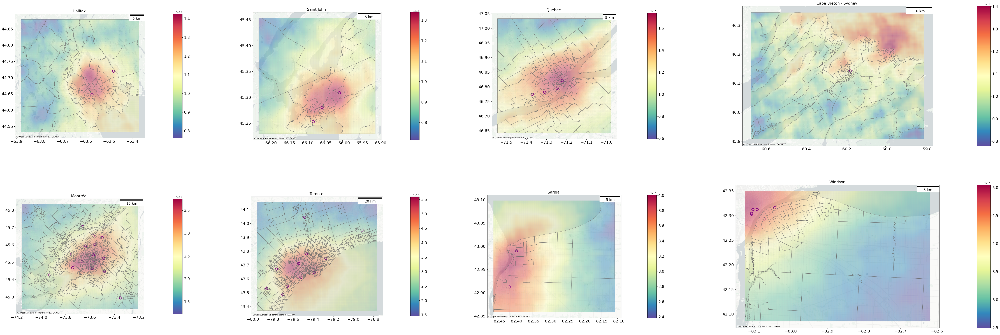

In [ ]:
###  TROPOMI annual average (2023/09 - 2024/08)

fig = plt.figure(figsize=(16*3 + 24, 12*2))
gspec = gridspec.GridSpec(nrows=2, ncols=4, width_ratios=[1, 1, 1, 1.5], height_ratios=[1, 1])

plot_xr = fetch_plot_Xr(tropomi_atl, coord_atl_gdf_tropomi)
plot_xr_qw = fetch_plot_Xr(tropomi_qw, coord_qw_gdf_tropomi)

plot_order = ["Halifax", "Saint John", "Québec", "Cape Breton - Sydney",
              "Montréal", "Toronto", "Sarnia", "Windsor"]

for c in range(len(plot_order)):

    city = plot_order[c]
    ax = plt.subplot(gspec[c])

    ax.tick_params(axis='both', which='major', labelsize=16)

    if city != "Cape Breton - Sydney" and city in ["Halifax", "Saint John"]:
        subset_plot_xr = city_subset(city, plot_xr)
        subset_plot_xr = city_convert_gdf(city, subset_plot_xr)
        city_plot_with_stations(city, subset_plot_xr, ax, aggregate_key="", vmax=None, vmin=None, title=True, fill_point_color="none", edge_point_color="purple", edge_point_width = 2)
        intersect_cts[city].plot(ax=ax, facecolor="none", edgecolor="dimgrey", linewidth=0.5)

    elif city != "Cape Breton - Sydney" and city in ["Québec", "Montréal", "Toronto", "Sarnia", "Windsor"]:
        subset_plot_xr = city_subset(city, plot_xr_qw)
        subset_plot_xr = city_convert_gdf(city, subset_plot_xr)
        city_plot_with_stations(city, subset_plot_xr, ax, aggregate_key="", vmax=None, vmin=None, title=True, fill_point_color="none", edge_point_color="purple", edge_point_width = 2)
        intersect_cts[city].plot(ax=ax, facecolor="none", edgecolor="dimgrey", linewidth=0.5)

    else:
        subset_plot_xr = city_subset(city, plot_xr)
        subset_plot_xr = subset_plot_xr.interpolate_na(dim="x", method="cubic")
        subset_plot_xr = city_convert_gdf(city, subset_plot_xr)
        city_plot_with_stations(city, subset_plot_xr, ax, aggregate_key="", vmax=None, vmin=None, title=True, fill_point_color="none", edge_point_color="purple", edge_point_width = 2)
        intersect_das[city].plot(ax=ax, facecolor="none", edgecolor="dimgrey", linewidth=0.5)

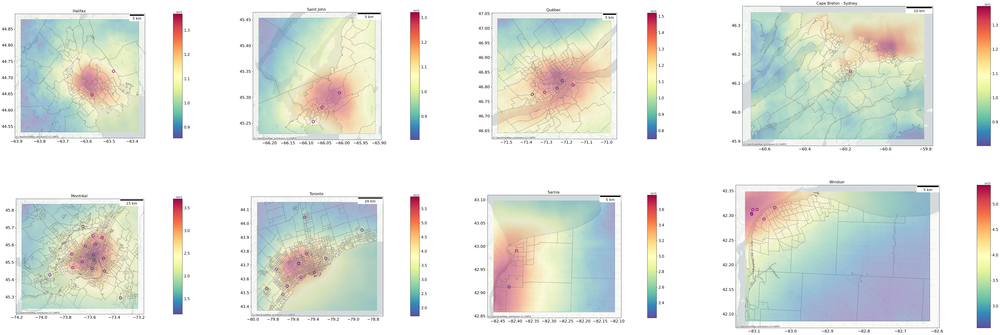

In [ ]:
###  TROPOMI 5-year average (2018/09 - 2023/08)

fig = plt.figure(figsize=(16*3 + 24, 12*2))
gspec = gridspec.GridSpec(nrows=2, ncols=4, width_ratios=[1, 1, 1, 1.5], height_ratios=[1, 1])

plot_xr = fetch_plot_Xr(tropomi_5yr_atl, coord_atl_gdf_tropomi)
plot_xr_qw = fetch_plot_Xr(tropomi_5yr_qw, coord_qw_gdf_tropomi)

plot_order = ["Halifax", "Saint John", "Québec", "Cape Breton - Sydney",
              "Montréal", "Toronto", "Sarnia", "Windsor"]

for c in range(len(plot_order)):

    city = plot_order[c]
    ax = plt.subplot(gspec[c])

    ax.tick_params(axis='both', which='major', labelsize=16)

    if city != "Cape Breton - Sydney" and city in ["Halifax", "Saint John"]:
        subset_plot_xr = city_subset(city, plot_xr)
        subset_plot_xr = city_convert_gdf(city, subset_plot_xr)
        city_plot_with_stations(city, subset_plot_xr, ax, aggregate_key="", vmax=None, vmin=None, title=True, fill_point_color="none", edge_point_color="purple", edge_point_width = 2)
        intersect_cts[city].plot(ax=ax, facecolor="none", edgecolor="dimgrey", linewidth=0.5)

    elif city != "Cape Breton - Sydney" and city in ["Québec", "Montréal", "Toronto", "Sarnia", "Windsor"]:
        subset_plot_xr = city_subset(city, plot_xr_qw)
        subset_plot_xr = city_convert_gdf(city, subset_plot_xr)
        city_plot_with_stations(city, subset_plot_xr, ax, aggregate_key="", vmax=None, vmin=None, title=True, fill_point_color="none", edge_point_color="purple", edge_point_width = 2)
        intersect_cts[city].plot(ax=ax, facecolor="none", edgecolor="dimgrey", linewidth=0.5)

    else:
        subset_plot_xr = city_subset(city, plot_xr)
        subset_plot_xr = city_convert_gdf(city, subset_plot_xr)
        city_plot_with_stations(city, subset_plot_xr, ax, aggregate_key="", vmax=None, vmin=None, title=True, fill_point_color="none", edge_point_color="purple", edge_point_width = 2)
        intersect_das[city].plot(ax=ax, facecolor="none", edgecolor="dimgrey", linewidth=0.5)

#### **2) Regional (Census Population Center) -level Monitoring Gaps:**

In [ ]:
####  spatial colocation

def colocate_tempo_tropomi(data,                ## original image to be resampled
                           coords,              ## original image's grid coordinates
                           target_grid,         ## targeted grid coordinates for resampling
                           resampling_scheme    ## resampling method
                           ):

    df = pd.DataFrame({
        "latitude": coords.latitude,
        "longitude": coords.longitude,
        "observation": data.flatten()
    })

    df = xr.Dataset.from_dataframe(df.set_index(['longitude','latitude']))
    df = df.rio.write_crs("epsg:4326")
    df = df.rename({"longitude": "x", "latitude": "y"})
    df = df.transpose("y", "x")
    df = df.reindex(y=list(reversed(df.y)))

    df = df.rio.reproject_match(
                    target_grid,
                    resampling = resampling_scheme
                )

    return df

In [ ]:
##  reprojecting / interpolating TEMPO observations to TROPOMI grids for colocation

no2_annual_atl_xr_coloc = colocate_tempo_tropomi(
    no2_annual_atl,
    coord_atl_gdf,
    no2_annual_tropomi_atl_xr,
    rio.enums.Resampling.bilinear
)

no2_annual_qw_xr_coloc = colocate_tempo_tropomi(
    no2_annual_qw,
    coord_qw_gdf,
    no2_annual_tropomi_qw_xr,
    rio.enums.Resampling.bilinear
)

In [ ]:
##  calculating population center area-weighted mean of TEMPO and TROPOMI annual averaged NO2
##  calculating population center's percentile ranks in regional TEMPO & TROPOMI distributions
##  calculating distance of the population center to the nearest monitoring stations (unmonitored or not)

def tempo_tropomi_percentile_ranks(shapefile,     ##  census boundaries
                                   tempo_obs,     ##  colocated TEMPO observations (xr.dataset)
                                   tropomi_obs,   ##  colocated TROPOMI observations (xr.dataset)
                                   station_loc    ##  AirNow surface NO2 monitors' locations (geodataframe)
                                   ):

    ## 1) area-weighted mean NO2

    zs_no2_tempo = eet.exact_extract(tempo_obs, shapefile, 'mean')
    zs_no2_tempo = [atl_pc_no2_tempo[n]['properties']['mean'] for n in range(shapefile.shape[0])]
    zs_shp['tempo_no2'] = pd.Series(atl_pc_no2_tempo)

    zs_no2_tropomi = eet.exact_extract(tropomi_obs, shapefile, 'mean')
    zs_no2_tropomi = [atl_pc_no2_tropomi[n]['properties']['mean'] for n in range(shapefile.shape[0])]
    zs_shp['tropomi_no2'] = pd.Series(atl_pc_no2_tropomi)

    ## 2) percentile ranks

    zs_shp['tempo_no2_percentile'] = shapefile['tempo_no2'].rank(pct=True)
    zs_shp['tropomi_no2_percentile'] = shapefile['tropomi_no2'].rank(pct=True)

    ## 3) distance to the nearest staions

    station_dist = shapefile.centroid.apply(lambda g: station_loc.distance(g))
    station_dist = station_dist.apply(lambda x: np.min(x), axis=1)

    shapefile['nearest_monitor'] = pd.Series(station_dist)

    ## 4) determine if it is an unmonitored hotspots

    with_station = gpd.sjoin(station_loc, shapefile, how='inner', predicate='within')
    monitored = shapefile[(shapefile['DGUID'].isin(with_station['DGUID'])) | (shapefile['nearest_monitor'] < 0.1)]
    unmonitored = shapefile[~shapefile['DGUID'].isin(monitored['DGUID'])]

    return unmonitored

In [ ]:
##  read all census population centers

pc_shp_path = f"./Shapefiles/Population Center/"
pc_shp = gpd.read_file(pc_shp_path + "lpc_000b21a_e.shp")

pc_shp = pc_shp.to_crs(epsg=4326)
pc_shp = pd.concat([pc_shp, pc_shp.geometry.bounds], axis=1)
pc_shp['centroid'] = pc_shp.geometry.centroid

##  filter all census population centers in Atlantic Canada

atl_pc_shp = pc_shp[(pc_shp["minx"] > -69.05) &
                    (pc_shp["miny"] > 43.05) &
                    (pc_shp["maxx"] < -52.05) &
                    (pc_shp["maxy"] < 51.05)].reset_index(drop=True)

##  filter all census population centers in the QW corridor

qw_pc_shp = pc_shp[(pc_shp["minx"] > -86.05) &
                    (pc_shp["miny"] > 41.20) &
                    (pc_shp["maxx"] < -69.05) &
                    (pc_shp["maxy"] < 48.20)].reset_index(drop=True)

##  extract unmonitored and high-pollution population centers

atl_pc_unmonitored = tempo_tropomi_percentile_ranks(atl_pc_shp, no2_annual_atl_xr_coloc, no2_annual_tropomi_atl_xr, atl_stations)
qw_pc_unmonitored = tempo_tropomi_percentile_ranks(qw_pc_shp, no2_annual_qw_xr_coloc, no2_annual_tropomi_qw_xr, qw_stations)

In [ ]:
###  percentile rank difference between TEMPO and TROPOMI > 0.5
atl_pc_unmonitored[(atl_pc_unmonitored['tempo_no2_percentile'] - atl_pc_unmonitored['tropomi_no2_percentile']) > 0.5]

,PCUID,PCPUID,DGUID,DGUIDP,PCNAME,PCTYPE,PCCLASS,LANDAREA,PRUID,geometry,minx,miny,maxx,maxy,centroid,tempo_no2,tropomi_no2,tempo_no2_percentile,tropomi_no2_percentile,nearest_monitor
3,0036,240036,2021S05100036,None,Baie-Comeau,2,2,11.2833,24,"POLYGON ((-68.13315 49.24517, -68.13297 49.245...",-68.207285,49.198686,-68.128539,49.248395,POINT (-68.16211 49.21717),8.062582e+14,4.660609e+14,0.669355,0.088710,1.860881
8,0081,240081,2021S05100081,None,Bonaventure,4,2,2.8488,24,"POLYGON ((-65.45984 48.04824, -65.46193 48.048...",-65.506254,48.040912,-65.453910,48.056907,POINT (-65.47996 48.04953),9.955367e+14,5.146220e+14,0.887097,0.153226,0.465953
21,0155,100155,2021S05100155,None,Channel-Port aux Basques,4,2,5.1668,10,"MULTIPOLYGON (((-59.15726 47.56986, -59.15748 ...",-59.184748,47.561193,-59.123942,47.603538,POINT (-59.15424 47.58021),1.120948e+15,6.008180e+14,0.919355,0.290323,1.762007
58,0580,240580,2021S05100580,None,New Richmond,4,2,4.0368,24,"MULTIPOLYGON (((-65.84703 48.16242, -65.8472 4...",-65.883346,48.149206,-65.844057,48.188236,POINT (-65.86008 48.17208),7.725948e+14,4.590160e+14,0.596774,0.072581,0.606400
63,0668,240668,2021S05100668,None,Port-Cartier,4,2,4.8835,24,"MULTIPOLYGON (((-66.89028 50.01746, -66.89032 ...",-66.904070,50.013715,-66.840477,50.037461,POINT (-66.86981 50.02553),9.864206e+14,5.369747e+14,0.879032,0.193548,2.713886
69,0748,240748,2021S05100748,None,Sept-Îles,1,2,13.2456,24,"MULTIPOLYGON (((-66.40714 50.27042, -66.4069 5...",-66.431978,50.196229,-66.346082,50.274351,POINT (-66.38725 50.22842),9.660108e+14,5.598292e+14,0.846774,0.225806,2.725132
102,1337,241337,2021S05101337,None,Carleton,4,2,1.0269,24,"POLYGON ((-66.11962 48.10952, -66.11976 48.108...",-66.130423,48.098400,-66.100153,48.110465,POINT (-66.11706 48.10411),7.837890e+14,4.680859e+14,0.620968,0.096774,0.691641
109,1396,241396,2021S05101396,None,Maliotenam,2,2,0.7969,24,"POLYGON ((-66.19091 50.21523, -66.18998 50.214...",-66.206880,50.210300,-66.186640,50.219403,POINT (-66.19716 50.21432),9.454762e+14,4.800877e+14,0.814516,0.120968,2.665008
120,1469,241469,2021S05101469,None,Maria,4,2,2.9686,24,"POLYGON ((-65.96416 48.18878, -65.96459 48.188...",-66.014259,48.168857,-65.958209,48.195110,POINT (-65.98854 48.18005),8.198538e+14,4.324788e+14,0.693548,0.064516,0.671911


In [ ]:
###  percentile rank difference between TEMPO and TROPOMI > 0.5
qw_pc_unmonitored[(qw_pc_unmonitored['tempo_no2_percentile'] - qw_pc_unmonitored['tropomi_no2_percentile']) > 0.5]

,PCUID,PCPUID,DGUID,DGUIDP,PCNAME,PCTYPE,PCCLASS,LANDAREA,PRUID,geometry,minx,miny,maxx,maxy,centroid,tempo_no2,tropomi_no2,tempo_no2_percentile,tropomi_no2_percentile,nearest_monitor


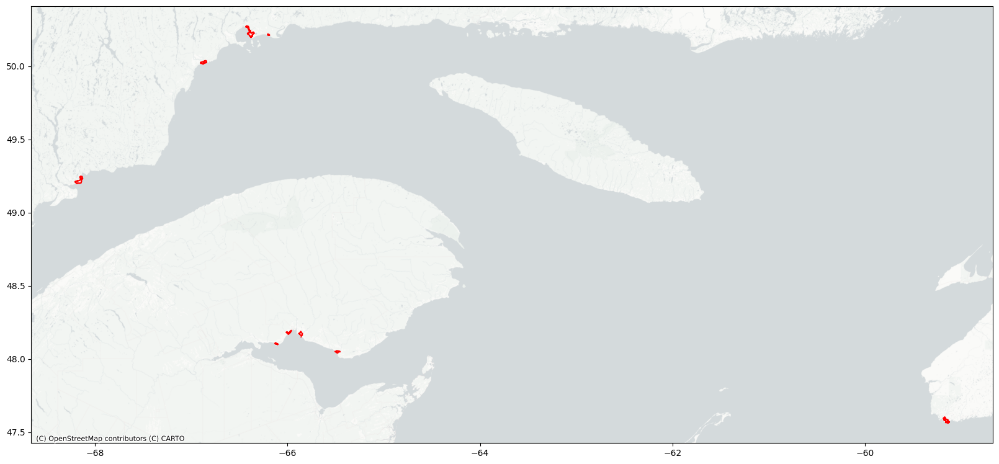

In [ ]:
###  Plot locations of population centers with percentile rank difference between TEMPO and TROPOMI > 0.5

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(20,12))

atl_pc_unmonitored[(atl_pc_unmonitored['tempo_no2_percentile'] - atl_pc_unmonitored['tropomi_no2_percentile']) > 0.5].plot(
    ax=ax,
    facecolor="none",
    edgecolor="red",
    linewidth=1.5,
    )

contextily.add_basemap(
        ax=ax,
        crs="epsg:4326",
        source=contextily.providers.CartoDB.PositronNoLabels,
        zoom=10
    )

<Axes: >

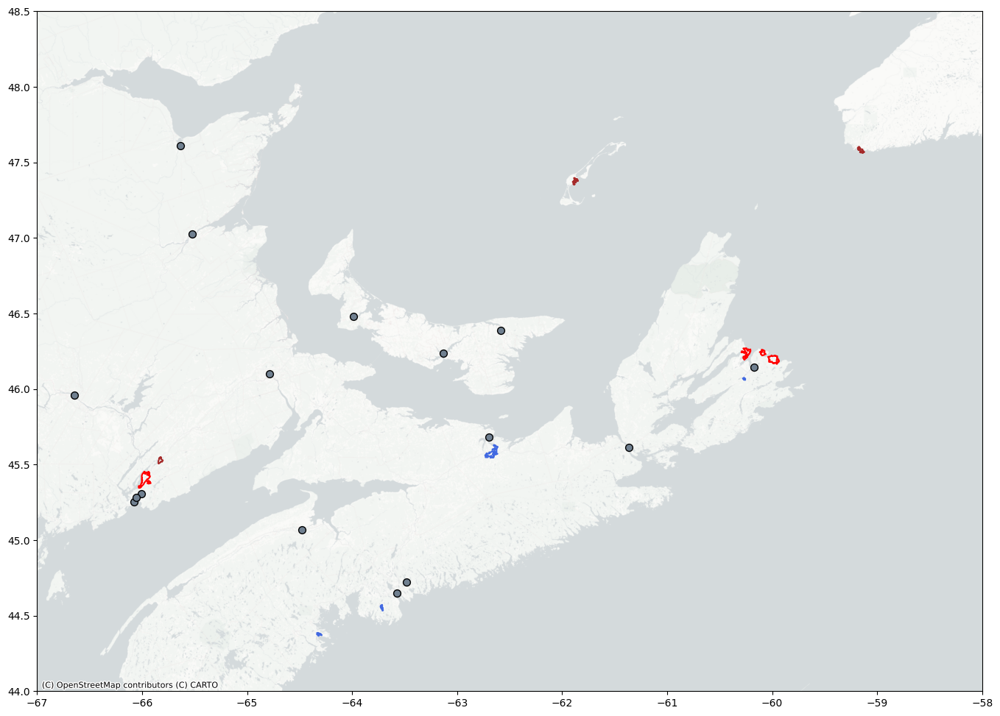

In [ ]:
###  Plot locations of population centers recognized as hotspots (top decile > 90%) by TEMPO and/or TROPOMI

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(20,12))

ax.set_xlim(-67.0, -58.0)
ax.set_ylim(44.0, 48.5)

#  observed from TEMPO + TROPOMI annual mean

atl_pc_unmonitored[(atl_pc_unmonitored['tempo_no2_percentile']  > 0.90) & (atl_pc_unmonitored['tropomi_no2_percentile']  > 0.90)].plot(
    ax=ax,
    facecolor="none",
    edgecolor="red",
    linewidth=1.5,
    )

#  observed from TEMPO but not TROPOMI annual mean

atl_pc_unmonitored[(atl_pc_unmonitored['tempo_no2_percentile']  > 0.90) & (~(atl_pc_unmonitored['tropomi_no2_percentile']  > 0.90))].plot(
    ax=ax,
    facecolor="none",
    edgecolor="brown",
    linewidth=1.5,
    )

#  observed from TROPOMI but not TEMPO annual mean

atl_pc_unmonitored[(~(atl_pc_unmonitored['tempo_no2_percentile']  > 0.90)) & (atl_pc_unmonitored['tropomi_no2_percentile']  > 0.90)].plot(
    ax=ax,
    facecolor="none",
    edgecolor="royalblue",
    linewidth=1.5,
    )

contextily.add_basemap(
    ax=ax,
    crs="epsg:4326",
    source=contextily.providers.CartoDB.PositronNoLabels,
    zoom=10
    )

atl_stations.plot(
    ax = ax,
    facecolor="slategrey",
    edgecolor="black",
    markersize=50
)

<Axes: >

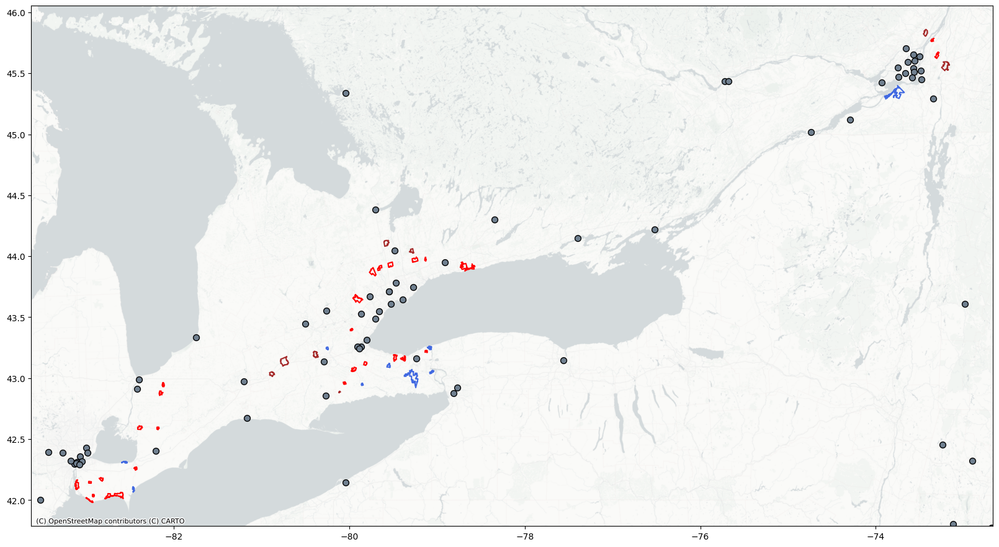

In [ ]:
###  Plot locations of population centers recognized as hotspots (top decile > 90%) by TEMPO and/or TROPOMI

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(20,12))

#  observed from TEMPO + TROPOMI annual mean

qw_pc_unmonitored[(qw_pc_unmonitored['tempo_no2_percentile']  > 0.90) & (qw_pc_unmonitored['tropomi_no2_percentile']  > 0.90)].plot(
    ax=ax,
    facecolor="none",
    edgecolor="red",
    linewidth=1.5,
    )

#  observed from TEMPO but not TROPOMI annual mean

qw_pc_unmonitored[(qw_pc_unmonitored['tempo_no2_percentile']  > 0.90) & (~(qw_pc_unmonitored['tropomi_no2_percentile']  > 0.90))].plot(
    ax=ax,
    facecolor="none",
    edgecolor="brown",
    linewidth=1.5,
    )

#  observed from TROPOMI but not TEMPO annual mean

qw_pc_unmonitored[(~(qw_pc_unmonitored['tempo_no2_percentile']  > 0.90)) & (qw_pc_unmonitored['tropomi_no2_percentile']  > 0.90)].plot(
    ax=ax,
    facecolor="none",
    edgecolor="royalblue",
    linewidth=1.5,
    )

contextily.add_basemap(
    ax=ax,
    crs="epsg:4326",
    source=contextily.providers.CartoDB.PositronNoLabels,
    zoom=10
    )

qw_stations.plot(
    ax = ax,
    facecolor="slategrey",
    edgecolor="black",
    markersize=50
)

#### **3) Local (selected municipalities) -level Monitoring Gaps:**

In [ ]:
#  initialize
needed = []
monitored = []


for city in ["Halifax", "Saint John", "Québec", "Cape Breton - Sydney", "Montréal", "Toronto", "Sarnia", "Windsor"]:

    if city in ["Halifax", "Saint John", "Cape Breton - Sydney"]:

        subset_tempo_xr = city_subset(city, no2_annual_atl_xr)
        subset_tropomi_xr = city_subset(city, no2_annual_tropomi_atl_5yr_xr)

    else:

        subset_tempo_xr = city_subset(city, no2_annual_qw_xr)
        subset_tropomi_xr = city_subset(city, no2_annual_tropomi_qw_5yr_xr)

    #  combine city-level TEMPO and TROPOMI datasets

    subset_tempo_gdf = city_convert_gdf(city, subset_tempo_xr)
    subset_tropomi_gdf = city_convert_gdf(city, subset_tropomi_xr)

    subset_tempo_gdf.columns = ["id","geometry","lon","lat","y","x","tempo_no2","spatial_ref"]
    subset_tropomi_gdf.columns = ["id","geometry","lon","lat","y","x","tropomi_no2","spatial_ref"]

    subset_gdf = subset_tempo_gdf.merge(subset_tropomi_gdf, on=["id","geometry","lon","lat","y","x","spatial_ref"], how="inner")

    #  calculate percentile rank for each grid within the city

    subset_gdf['tempo_no2_percentile'] = subset_gdf['tempo_no2'].rank(pct=True)
    subset_gdf['tropomi_no2_percentile'] = subset_gdf['tropomi_no2'].rank(pct=True)

    subset_gdf['centroid'] = subset_gdf.geometry.centroid
    subset_gdf['Extent'] = city

    #  interpolate TEMPO and TROPOMI values at the exact coordinates of each monitor within the city

    bound_stations = stations[(stations['Longitude'] >= np.min(pc_grids_coords[city].lon)) &
                              (stations['Longitude'] <= np.max(pc_grids_coords[city].lon)) &
                              (stations['Latitude'] >= np.min(pc_grids_coords[city].lat)) &
                              (stations['Latitude'] <= np.max(pc_grids_coords[city].lat))].reset_index(drop=True)

    bound_stations['Extent'] = city

    tempo_val_extract = []
    tropomi_val_extract = []

    for s in range(bound_stations.shape[0]):

        x_coord = bound_stations.Longitude.iloc[s]
        y_coord = bound_stations.Latitude.iloc[s]
        tempo_val = subset_tempo_xr.interp({'x':x_coord, 'y':y_coord}, method='linear').observation.values.tolist()
        tropomi_val = subset_tropomi_xr.interp({'x':x_coord, 'y':y_coord}, method='linear').observation.values.tolist()

        tempo_val_extract.append(tempo_val)
        tropomi_val_extract.append(tropomi_val)

    bound_stations['TEMPO'] = pd.Series(tempo_val_extract)
    bound_stations['TROPOMI'] = pd.Series(tropomi_val_extract)

    #  calculate the ratio between the values measured at the monitor locations and the 98-percentile of NO2 distributions within the city

    bound_stations['TEMPO_quotient_98'] = bound_stations['TEMPO'] / np.nanpercentile(subset_tempo_xr.observation.values, 98)
    bound_stations['TROPOMI_quotient_98'] = bound_stations['TROPOMI'] / np.nanpercentile(subset_tropomi_xr.observation.values, 98)

    #  filter hotspots

    subset_gdf = subset_gdf[(subset_gdf["tempo_no2_percentile"] > 0.90) | (subset_gdf["tropomi_no2_percentile"] > 0.90)].reset_index(drop=True)

    #  calculate distances between each hotspot (grid) and the nearest monitor within the city

    dist_list = []
    station_list = []

    for n in range(subset_gdf.shape[0]):
        dist_list.append(np.min(subset_gdf.iloc[n].centroid.distance(bound_stations.geometry)))
        station_list.append(bound_stations['NAPS ID'].iloc[
            np.argmin(subset_gdf.iloc[n].centroid.distance(bound_stations.geometry))
            ])

    subset_gdf['nearest_monitor_dist_km'] = pd.Series(dist_list) * 111
    subset_gdf['nearest_monitor_id'] = pd.Series(station_list)
    subset_gdf = subset_gdf.drop(['centroid'], axis=1)


    #  write/output
    monitored.append(bound_stations)
    needed.append(subset_gdf)

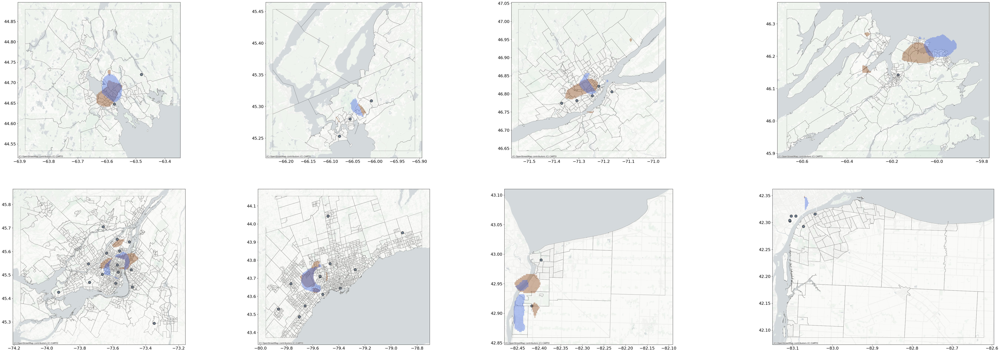

In [ ]:
###  TEMPO vs TROPOMI un-monitored hotspots
###   =>   in-situ grid NO2 > 98-th percentile; and
###   =>   in-situ grid > 5 km from the nearest monitor, or the nearest monitor has NO2 < 98-th percentile


fig = plt.figure(figsize=(16*3 + 24, 12*2))
gspec = gridspec.GridSpec(nrows=2, ncols=4, width_ratios=[1, 1, 1, 1.5], height_ratios=[1, 1])

plot_order = ["Halifax", "Saint John", "Québec", "Cape Breton - Sydney",
              "Montréal", "Toronto", "Sarnia", "Windsor"]


plot_xr = fetch_plot_Xr(no2_annual_atl, coord_atl_gdf)
plot_xr_qw = fetch_plot_Xr(no2_annual_qw, coord_qw_gdf)


for c in range(len(plot_order)):

    city = plot_order[c]
    ax = plt.subplot(gspec[c])

    ax.tick_params(axis='both', which='major', labelsize=16)

    plot_df_tempo = needed[(needed["Extent"] == city) &
                           ((needed["tempo_no2_percentile"] > 0.98) & ((needed['TEMPO_quotient_98'] < 1.00) | (needed["nearest_monitor_dist_km"] > 5.5)))
                           ]

    plot_df_tropomi = needed[(needed["Extent"] == city) &
                             ((needed["tropomi_no2_percentile"] > 0.98) & ((needed['TROPOMI_quotient_98'] < 1.00) | (needed["nearest_monitor_dist_km"] > 5.5)))
                            ]

    if city != "Cape Breton - Sydney" and city in ["Halifax", "Saint John"]:

        subset_plot_xr = city_subset(city, plot_xr)
        subset_plot_xr = city_convert_gdf(city, subset_plot_xr)

        bound_stations = stations[(stations['Longitude'] >= np.min(subset_plot_xr.x.values)) &
                                  (stations['Longitude'] <= np.max(subset_plot_xr.x.values)) &
                                  (stations['Latitude'] >= np.min(subset_plot_xr.y.values)) &
                                  (stations['Latitude'] <= np.max(subset_plot_xr.y.values))]
        bound_stations.plot(
            ax = ax,
            color="slategrey",
            markersize=100,
            edgecolor='black',
            linewidth=1,
        )

        intersect_cts[city].plot(ax=ax, facecolor="none", edgecolor="dimgrey", linewidth=0.5)

    elif city != "Cape Breton - Sydney" and city in ["Québec", "Montréal", "Toronto", "Sarnia", "Windsor"]:

        subset_plot_xr = city_subset(city, plot_xr_qw)
        subset_plot_xr = city_convert_gdf(city, subset_plot_xr)

        bound_stations = stations[(stations['Longitude'] >= np.min(subset_plot_xr.x.values)) &
                                  (stations['Longitude'] <= np.max(subset_plot_xr.x.values)) &
                                  (stations['Latitude'] >= np.min(subset_plot_xr.y.values)) &
                                  (stations['Latitude'] <= np.max(subset_plot_xr.y.values))]
        bound_stations.plot(
            ax = ax,
            color="slategrey",
            markersize=100,
            edgecolor='black',
            linewidth=1,
        )

        intersect_cts[city].plot(ax=ax, facecolor="none", edgecolor="dimgrey", linewidth=0.5)

    else:

        subset_plot_xr = city_subset(city, plot_xr)
        subset_plot_xr = city_convert_gdf(city, subset_plot_xr)

        bound_stations = stations[(stations['Longitude'] >= np.min(subset_plot_xr.x.values)) &
                                  (stations['Longitude'] <= np.max(subset_plot_xr.x.values)) &
                                  (stations['Latitude'] >= np.min(subset_plot_xr.y.values)) &
                                  (stations['Latitude'] <= np.max(subset_plot_xr.y.values))]
        bound_stations.plot(
            ax = ax,
            color="slategrey",
            markersize=100,
            edgecolor='black',
            linewidth=1,
        )

        intersect_das[city].plot(ax=ax, facecolor="none", edgecolor="dimgrey", linewidth=0.5)

    contextily.add_basemap(
        ax=ax,
        crs="epsg:4326",
        source=contextily.providers.CartoDB.PositronNoLabels,
        zoom=12
    )

    plot_df_tempo.plot(
        ax=ax,
        facecolor="saddlebrown",
        edgecolor="saddlebrown",
        alpha=0.4,
        linewidth=0,
        aspect=None
    )

    plot_df_tropomi.plot(
        ax=ax,
        facecolor="royalblue",
        edgecolor="royalblue",
        alpha=0.4,
        linewidth=0,
        aspect=None
    )